# MASK-RCNN

In [1]:
!nvidia-smi

Tue Nov  4 09:54:51 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   48C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install roboflow
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!git clone https://github.com/facebookresearch/detectron2.git
%cd detectron2
!python -m pip install -e .


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 68.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 76.7 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11
Looking in indexes: https://download.pytorch.org/whl/cu118
Cloning into 'detectron2'...
remote: Enumerating objects: 15920, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 15920 (

In [3]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
print("Detectron2 installed and working!")


Detectron2 installed and working!


In [4]:
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader, Dataset
import cv2, os
from roboflow import Roboflow

QQP2hmDA6hdwWPeX6IJb

In [5]:
import os
from getpass import getpass

os.environ['ROBOFLOW_API_KEY'] = getpass('Enter Roboflow API key: ')


Enter Roboflow API key: ··········


In [6]:
from roboflow import Roboflow
rf = Roboflow(api_key=os.environ["ROBOFLOW_API_KEY"])
project = rf.workspace("tree-soyjd").project("queen-cells-segment-ri9y6-f88wd-p286k-bjq11")
version = project.version(1)
dataset = version.download("coco")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to queen-cells-segment-1 in coco:: 100%|██████████| 4572/4572 [00:03<00:00, 1158.49it/s]


In [11]:
import os, json
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


In [13]:
def get_classes_from_json(json_path):
    with open(json_path, 'r') as f:
        data = json.load(f)
    categories = sorted(data["categories"], key=lambda x: x["id"])
    return [c["name"] for c in categories]

class_names = get_classes_from_json(train_json)
print(" Loaded categories:", class_names)


 Loaded categories: ['queen-cells-SS5v-vrW4', 'capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


In [10]:
import glob

files = glob.glob("/content/**/*.json", recursive=True)
for f in files:
    print(f)


/content/detectron2/queen-cells-segment-1/train/_annotations.coco.json
/content/detectron2/queen-cells-segment-1/valid/_annotations.coco.json
/content/detectron2/queen-cells-segment-1/test/_annotations.coco.json
/content/sample_data/anscombe.json


# Data Cleaning

In [14]:
import json
import shutil

def fix_annotations(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    keep = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']

    new_categories = []
    name_to_newid = {}

    new_id = 0
    for c in data["categories"]:
        if c["name"] in keep:
            name_to_newid[c["id"]] = new_id
            new_categories.append({"id": new_id, "name": c["name"]})
            new_id += 1

    new_annotations = []
    for ann in data["annotations"]:
        old_id = ann["category_id"]
        if old_id in name_to_newid:
            ann["category_id"] = name_to_newid[old_id]
            new_annotations.append(ann)

    data["categories"] = new_categories
    data["annotations"] = new_annotations

    out = json_path.replace(".json", "_clean.json")
    with open(out, "w") as f:
        json.dump(data, f, indent=2)

    print(" Cleaned →", out)

fix_annotations(train_json)
fix_annotations(val_json)
fix_annotations(test_json)


 Cleaned → /content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json
 Cleaned → /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
 Cleaned → /content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json


In [17]:
import json

def show_classes(path):
    with open(path, "r") as f:
        data = json.load(f)
    print("CLASSES:", [c["name"] for c in data["categories"]])

show_classes("/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json")
show_classes("/content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json")
show_classes("/content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json")


CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


# Register Dataset

In [18]:
from detectron2.data.datasets import register_coco_instances

root = "/content/detectron2/queen-cells-segment-1"

register_coco_instances(
    "queen_train", {},
    f"{root}/train/_annotations.coco_clean.json",
    f"{root}/train"
)

register_coco_instances(
    "queen_val", {},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

register_coco_instances(
    "queen_test", {},
    f"{root}/test/_annotations.coco_clean.json",
    f"{root}/test"
)


In [20]:
from detectron2.data import MetadataCatalog

CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

for d in ["queen_train", "queen_val", "queen_test"]:
    MetadataCatalog.get(d).thing_classes = CLASSES


In [22]:
import json

valid_names = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

json_files = [
    train_json.replace(".json", "_clean.json"),
    val_json.replace(".json", "_clean.json"),
    test_json.replace(".json", "_clean.json"),
]


# Checking ID or Mismatch

In [23]:
def check_json_classes(json_path):
    print("\nChecking:", json_path)
    with open(json_path, "r") as f:
        data = json.load(f)

    categories = data["categories"]
    ann = data["annotations"]

    print(" Categories found:")
    for c in categories:
        print(f"  id={c['id']}  name={c['name']}")

    errors = False
    for c in categories:
        if c["name"] not in valid_names:
            print(" INVALID NAME:", c)
            errors = True

    ids = sorted([c["id"] for c in categories])
    if ids != list(range(len(valid_names))):
        print(" category_id mismatch! Expected:", list(range(len(valid_names))), "Got:", ids)
        errors = True

    invalid_anns = [a for a in ann if a["category_id"] not in ids]
    if invalid_anns:
        print(" Annotation ID mismatch (wrong category_id)")
        print(" Example:", invalid_anns[:5])
        errors = True

    if not errors:
        print("  All good!")

for js in json_files:
    check_json_classes(js)



Checking: /content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!

Checking: /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!

Checking: /content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!


In [24]:
meta = MetadataCatalog.get("queen_train")
print("Classes:", meta.thing_classes)


Classes: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


In [27]:
import json

path = "/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json"   # <-- change to your actual filename
with open(path, "r") as f:
    data = json.load(f)

print(data)

{'info': {'year': '2025', 'version': '1', 'description': 'Exported from roboflow.com', 'contributor': '', 'url': 'https://app.roboflow.com/datasets/queen-cells-segment-ri9y6-f88wd-p286k-bjq11/1', 'date_created': '2025-11-03T07:33:47+00:00'}, 'licenses': [{'id': 1, 'url': 'https://creativecommons.org/licenses/by/4.0/', 'name': 'CC BY 4.0'}], 'categories': [{'id': 0, 'name': 'capped_cell'}, {'id': 1, 'name': 'failed_cell'}, {'id': 2, 'name': 'matured_cell'}, {'id': 3, 'name': 'open_cell'}, {'id': 4, 'name': 'semi-matured_cell'}], 'images': [{'id': 0, 'license': 1, 'file_name': 'images-4-_jpeg.rf.7f8e961a8867b4cddb291492a60bbcd7.jpg', 'height': 640, 'width': 640, 'date_captured': '2025-11-03T07:33:47+00:00', 'extra': {'name': 'images-4-.jpeg'}}, {'id': 1, 'license': 1, 'file_name': 'IMG_1426_jpeg.rf.4096030f1bdae34caa330faa1e4348c0.jpg', 'height': 640, 'width': 640, 'date_captured': '2025-11-03T07:33:47+00:00', 'extra': {'name': 'IMG_1426.jpeg'}}, {'id': 2, 'license': 1, 'file_name': 'IMG

# Recheck ID

In [31]:
import json
from collections import Counter

path = "/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json"

with open(path, "r") as f:
    data = json.load(f)

counts = Counter([ann["category_id"] for ann in data["annotations"]])

print("CATEGORY MAP:", {c["id"]: c["name"] for c in data["categories"]})
print()
print("COUNTS:")
for c in data["categories"]:
    cid = c["id"]
    cname = c["name"]
    print(f"ID {cid} → {cname}: {counts.get(cid, 0)}")


CATEGORY MAP: {0: 'capped_cell', 1: 'failed_cell', 2: 'matured_cell', 3: 'open_cell', 4: 'semi-matured_cell'}

COUNTS:
ID 0 → capped_cell: 3483
ID 1 → failed_cell: 978
ID 2 → matured_cell: 7977
ID 3 → open_cell: 4166
ID 4 → semi-matured_cell: 4294


# Configuration

In [35]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()

cfg.merge_from_file(
    "/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
)

cfg.DATASETS.TRAIN = ("queen_train",)
cfg.DATASETS.TEST  = ("queen_val",)

cfg.DATALOADER.NUM_WORKERS = 2

cfg.MODEL.WEIGHTS = (
    "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"
)

cfg.MODEL.RESUME = False
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5

cfg.OUTPUT_DIR = "/content/queen_output"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 6000
cfg.SOLVER.STEPS = []

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128


# Train MASK RCNN Model

In [34]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(False)
trainer.train()

[11/04 10:14:41 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:00, 219MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[11/04 10:14:42 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:4322.)


[11/04 10:14:53 d2.utils.events]:  eta: 0:32:00  iter: 19  total_loss: 3.136  loss_cls: 1.631  loss_box_reg: 0.5436  loss_mask: 0.6913  loss_rpn_cls: 0.2045  loss_rpn_loc: 0.02548    time: 0.3263  last_time: 0.3060  data_time: 0.0158  last_data_time: 0.0047   lr: 4.9953e-06  max_mem: 1862M
[11/04 10:15:06 d2.utils.events]:  eta: 0:31:30  iter: 39  total_loss: 3.174  loss_cls: 1.541  loss_box_reg: 0.6238  loss_mask: 0.6894  loss_rpn_cls: 0.2505  loss_rpn_loc: 0.02602    time: 0.3193  last_time: 0.3694  data_time: 0.0061  last_data_time: 0.0072   lr: 9.9902e-06  max_mem: 1928M
[11/04 10:15:12 d2.utils.events]:  eta: 0:31:20  iter: 59  total_loss: 2.674  loss_cls: 1.34  loss_box_reg: 0.4268  loss_mask: 0.6836  loss_rpn_cls: 0.1699  loss_rpn_loc: 0.02529    time: 0.3204  last_time: 0.3524  data_time: 0.0074  last_data_time: 0.0086   lr: 1.4985e-05  max_mem: 1928M
[11/04 10:15:19 d2.utils.events]:  eta: 0:31:19  iter: 79  total_loss: 2.611  loss_cls: 1.164  loss_box_reg: 0.5526  loss_mask: 

# Evaluate Results

In [36]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("queen_val", cfg, False, output_dir=cfg.OUTPUT_DIR)

val_loader = build_detection_test_loader(cfg, "queen_val")

results = inference_on_dataset(trainer.model, val_loader, evaluator)

print(results)

WARNING [11/04 10:50:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [11/04 10:50:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/04 10:50:45 d2.data.datasets.coco]: Loaded 200 images in COCO format from /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
[11/04 10:50:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/04 10:50:45 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[11/04 10:50:45 d2.data.common]: Serializing 200 elements to byte tensors and concatenating them all ...
[11/04 10:50:45 d2.data.common]: Serialized dataset takes 0.23 MiB
[11/04 10:50:45 d2.evaluation.evaluator]: Start inference on 200 bat

# Get Model Weights

In [37]:
from google.colab import files

model_path = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

if os.path.exists(model_path):
    files.download(model_path)
    print(f"Model downloaded successfully from: {model_path}")
else:
    print(f"Model file not found at: {model_path}")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Model downloaded successfully from: /content/queen_output/model_final.pth


# Test Images

In [66]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
import cv2, os

img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/detectron2/visual_samples"
os.makedirs(output_dir, exist_ok=True)

for image_name in os.listdir(img_dir):
    if not image_name.lower().endswith((".jpg", ".jpeg", ".png")):
        continue

    img_path = os.path.join(img_dir, image_name)
    im = cv2.imread(img_path)
    if im is None:
        print(" Cannot read:", img_path)
        continue

    outputs = predictor(im)

    v = Visualizer(
        im[:, :, ::-1],
        metadata=MetadataCatalog.get("queen_cells_train"),
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )

    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    save_path = os.path.join(output_dir, image_name)
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)


Done! Check folder: /content/detectron2/visual_samples


In [67]:
!ls /content
!ls /content/test_images


detectron2  faster_output  queen_output  sample_data  visualized_output
ls: cannot access '/content/test_images': No such file or directory


In [68]:
!ls /content/detectron2


build		     dev		 MODEL_ZOO.md		tests
configs		     docker		 projects		tools
datasets	     docs		 queen-cells-segment-1	visual_samples
demo		     GETTING_STARTED.md  README.md
detectron2	     INSTALL.md		 setup.cfg
detectron2.egg-info  LICENSE		 setup.py


In [69]:
!find /content -type d -name "valid"


/content/detectron2/queen-cells-segment-1/valid


In [77]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import cv2, os
import glob, random

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

cfg_mask_rcnn = get_cfg()
cfg_mask_rcnn.merge_from_file("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg_mask_rcnn.MODEL.WEIGHTS = "/content/queen_output/model_final.pth"
cfg_mask_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5

predictor_mask_rcnn = DefaultPredictor(cfg_mask_rcnn)

img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/visualized_output_mask_rcnn"
os.makedirs(output_dir, exist_ok=True)

img_list = glob.glob(f"{img_dir}/*")

sample_imgs = random.sample(img_list, min(6, len(img_list)))

MASK_RCNN_CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

if "queen_val" in DatasetCatalog.keys():
    DatasetCatalog.remove("queen_val")
if "queen_val" in MetadataCatalog.keys():
    MetadataCatalog.remove("queen_val")

from detectron2.data.datasets import register_coco_instances
root = "/content/detectron2/queen-cells-segment-1"
register_coco_instances(
    "queen_val", {"thing_classes": MASK_RCNN_CLASSES},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

meta_mask_rcnn = MetadataCatalog.get("queen_val")


for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print(" Cannot read:", image_path)
        continue

    outputs = predictor_mask_rcnn(im)

    confidence_threshold = 0.5
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
      keep = instances.scores > confidence_threshold
      instances = instances[keep]


    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_mask_rcnn,
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )

    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)

[11/04 11:12:52 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output/model_final.pth ...
Done! Check folder: /content/visualized_output_mask_rcnn


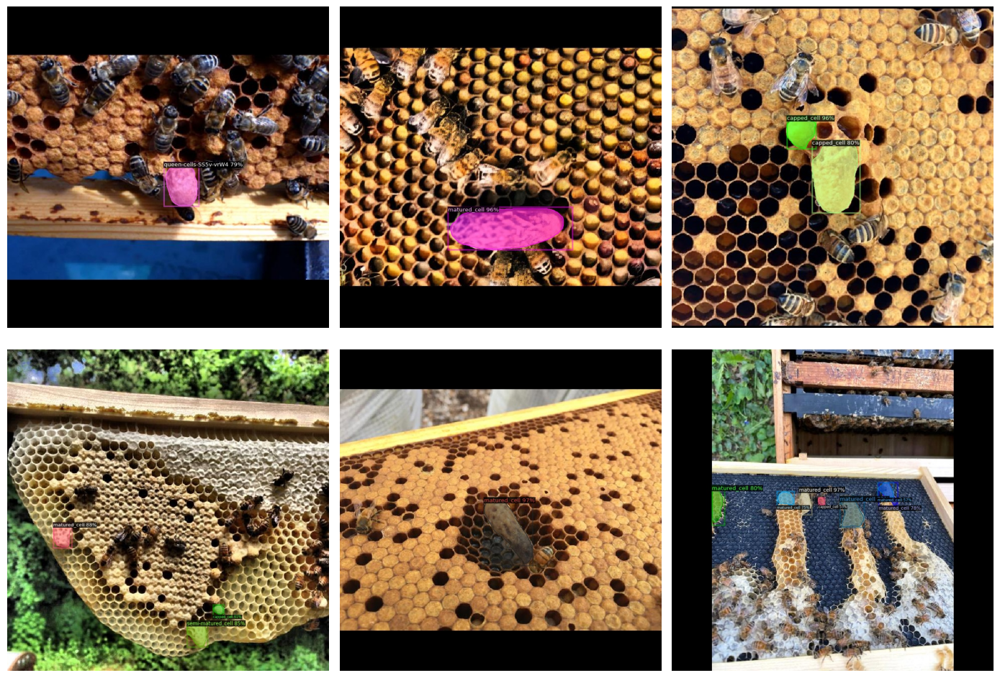

In [78]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_mask_rcnn = "/content/visualized_output_mask_rcnn"
results_mask_rcnn = glob.glob(f"{output_dir_mask_rcnn}/*")
samples_mask_rcnn = random.sample(results_mask_rcnn, min(6, len(results_mask_rcnn)))

plt.figure(figsize=(14, 10))

for i, img_path in enumerate(samples_mask_rcnn):
    plt.subplot(2, 3, i+1)
    img = cv2.imread(img_path)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")

plt.tight_layout()
plt.show()

In [84]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import cv2, os
import glob, random

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

cfg_mask_rcnn = get_cfg()
cfg_mask_rcnn.merge_from_file("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg_mask_rcnn.MODEL.WEIGHTS = "/content/queen_output/model_final.pth"
cfg_mask_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5

predictor_mask_rcnn = DefaultPredictor(cfg_mask_rcnn)


img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/visualized_output_mask_rcnn"
os.makedirs(output_dir, exist_ok=True)

img_list = glob.glob(f"{img_dir}/*")

sample_imgs = random.sample(img_list, min(6, len(img_list)))

MASK_RCNN_CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

if "queen_val" in DatasetCatalog.keys():
    DatasetCatalog.remove("queen_val")
if "queen_val" in MetadataCatalog.keys():
    MetadataCatalog.remove("queen_val")

from detectron2.data.datasets import register_coco_instances
root = "/content/detectron2/queen-cells-segment-1"
register_coco_instances(
    "queen_val", {"thing_classes": MASK_RCNN_CLASSES},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

meta_mask_rcnn = MetadataCatalog.get("queen_val")


for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print(" Cannot read:", image_path)
        continue

    outputs = predictor_mask_rcnn(im)
    confidence_threshold = 0.5
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
      keep = instances.scores > confidence_threshold
      instances = instances[keep]


    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_mask_rcnn,
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )

    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)

[11/04 11:17:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output/model_final.pth ...
Done! Check folder: /content/visualized_output_mask_rcnn


# Test on valid images

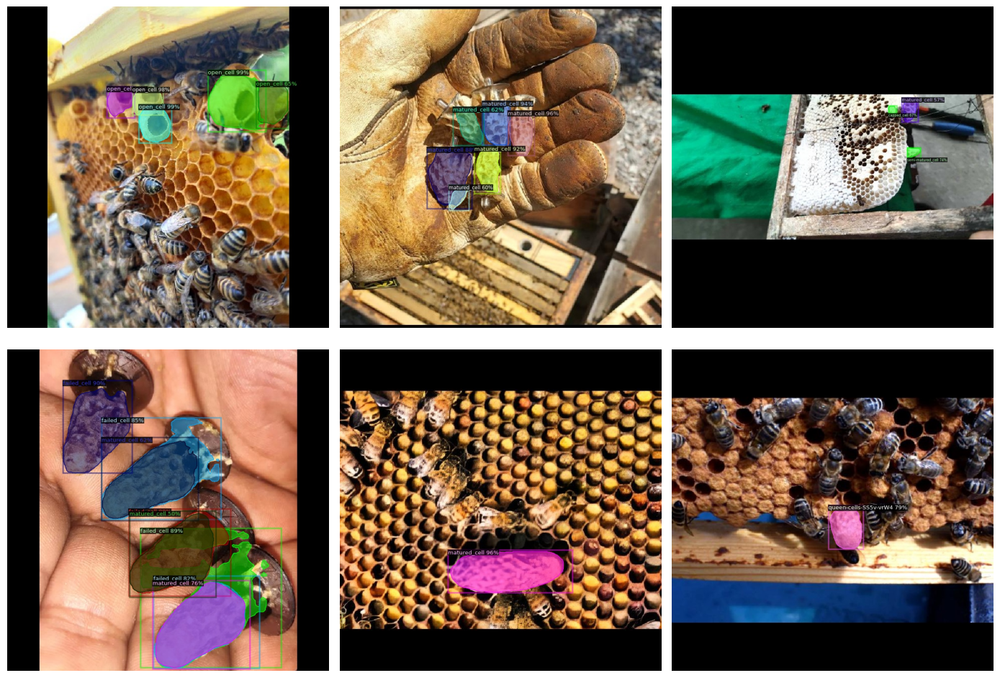

In [87]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_mask_rcnn = "/content/visualized_output_mask_rcnn"
results_mask_rcnn = glob.glob(f"{output_dir_mask_rcnn}/*")

if not results_mask_rcnn:
    print(f"No visualized images found in {output_dir_mask_rcnn}. Please run the visualization generation cell first.")
else:
    samples_mask_rcnn = random.sample(results_mask_rcnn, min(6, len(results_mask_rcnn)))

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_mask_rcnn):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")

    plt.tight_layout()
    plt.show()

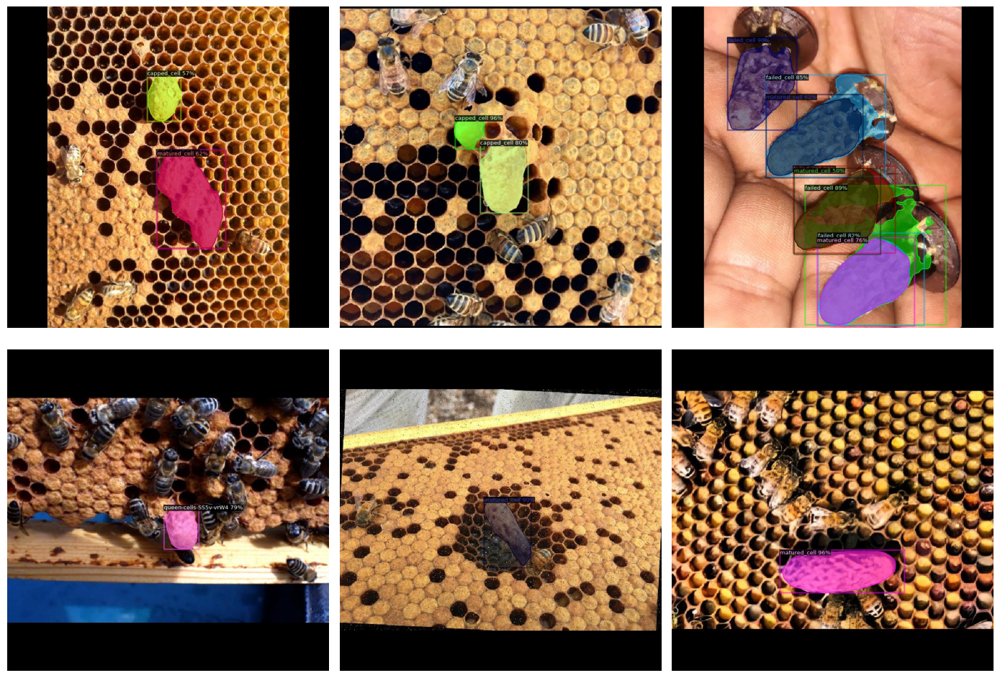

In [115]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os


output_dir_mask_rcnn = "/content/visualized_output_mask_rcnn"
results_mask_rcnn = glob.glob(f"{output_dir_mask_rcnn}/*")

if not results_mask_rcnn:
    print(f"No visualized images found in {output_dir_mask_rcnn}. Please run the visualization generation cell first.")
else:

    samples_mask_rcnn = random.sample(results_mask_rcnn, min(6, len(results_mask_rcnn)))

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_mask_rcnn):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Test on test images

[11/04 11:50:31 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output/model_final.pth ...
Cannot read: /content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json
✅ Test images visualized and saved in: /content/visualized_output_mask_rcnn_test


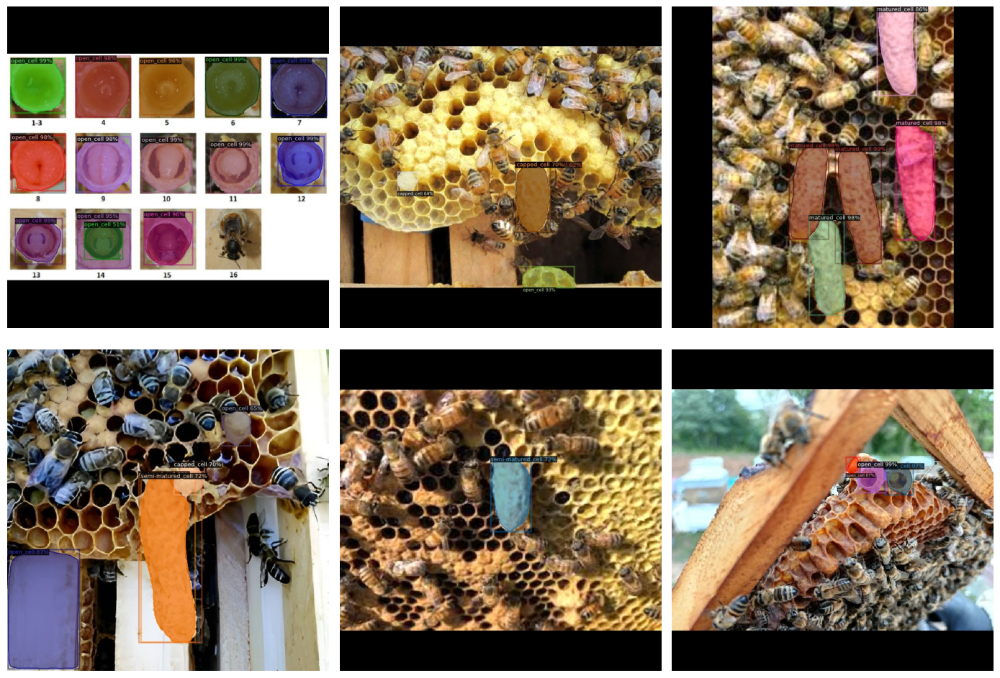

In [123]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog

import cv2, os, glob, random
import matplotlib.pyplot as plt
import shutil

cfg_mask_rcnn = get_cfg()
cfg_mask_rcnn.merge_from_file("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg_mask_rcnn.MODEL.WEIGHTS = "/content/queen_output/model_final.pth"
cfg_mask_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_mask_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_mask_rcnn = DefaultPredictor(cfg_mask_rcnn)

MASK_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"

test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)

register_coco_instances(
    test_dataset_name,
    {"thing_classes": MASK_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_mask_rcnn_test = MetadataCatalog.get(test_dataset_name)
-
output_dir_test = "/content/visualized_output_mask_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_dir = root_test
img_list = glob.glob(f"{img_dir}/*")

sample_imgs = random.sample(img_list, min(6, len(img_list)))

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_mask_rcnn(im)
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
        keep = instances.scores > cfg_mask_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_mask_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Test images visualized and saved in:", output_dir_test)

results_test = glob.glob(f"{output_dir_test}/*")
if results_test:
    plt.figure(figsize=(14, 10))
    samples_test = random.sample(results_test, min(6, len(results_test)))
    for i, img_path in enumerate(samples_test):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")

[11/04 11:51:07 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output/model_final.pth ...
 Test images visualized and saved in: /content/visualized_output_mask_rcnn_test


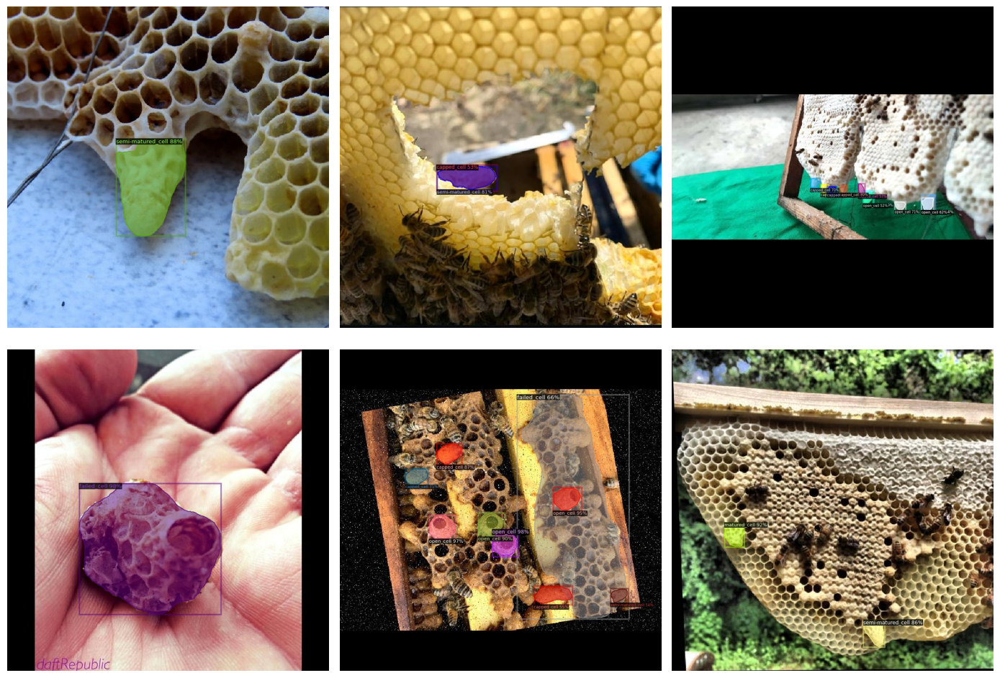

In [125]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog


import cv2, os, glob, random
import matplotlib.pyplot as plt
import shutil

cfg_mask_rcnn = get_cfg()
cfg_mask_rcnn.merge_from_file("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg_mask_rcnn.MODEL.WEIGHTS = "/content/queen_output/model_final.pth"
cfg_mask_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_mask_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_mask_rcnn = DefaultPredictor(cfg_mask_rcnn)

MASK_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"

test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)


register_coco_instances(
    test_dataset_name,
    {"thing_classes": MASK_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_mask_rcnn_test = MetadataCatalog.get(test_dataset_name)

output_dir_test = "/content/visualized_output_mask_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_dir = root_test
img_list = glob.glob(f"{img_dir}/*")

sample_imgs = random.sample(img_list, min(6, len(img_list)))
for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_mask_rcnn(im)
    instances = outputs["instances"].to("cpu")

    if instances.has("scores"):
        keep = instances.scores > cfg_mask_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_mask_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print(" Test images visualized and saved in:", output_dir_test)

results_test = glob.glob(f"{output_dir_test}/*")
if results_test:
    plt.figure(figsize=(14, 10))
    samples_test = random.sample(results_test, min(6, len(results_test)))
    for i, img_path in enumerate(samples_test):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")

# Graphs

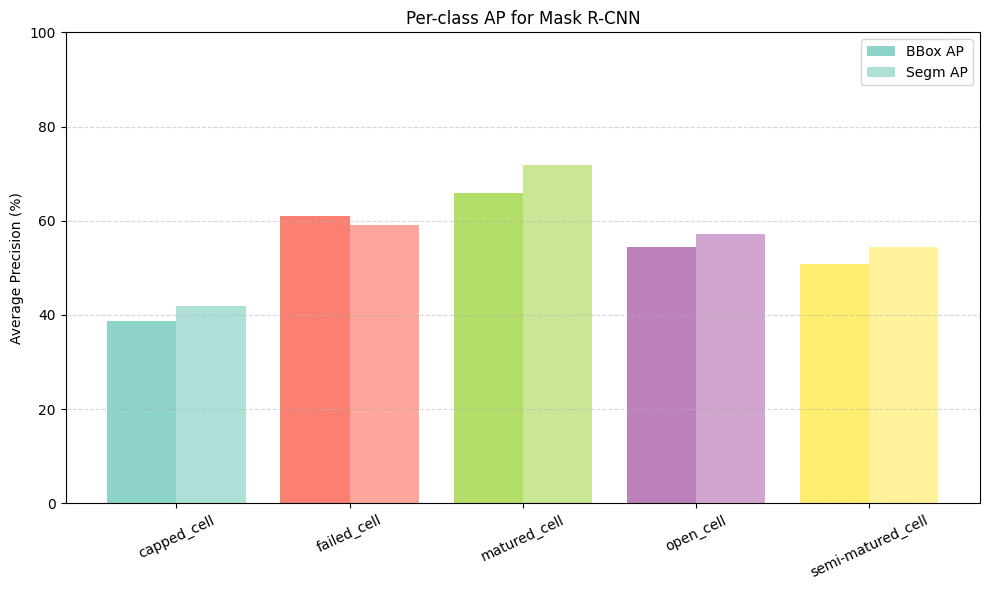

In [98]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

x = np.arange(len(classes))

colors = plt.cm.Set3(np.linspace(0, 1, len(classes)))

plt.figure(figsize=(10,6))
plt.bar(x - 0.2, bbox_ap, width=0.4, color=colors, label='BBox AP')
plt.bar(x + 0.2, segm_ap, width=0.4, color=colors, alpha=0.7, label='Segm AP')

plt.xticks(x, classes, rotation=25)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Mask R-CNN")
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


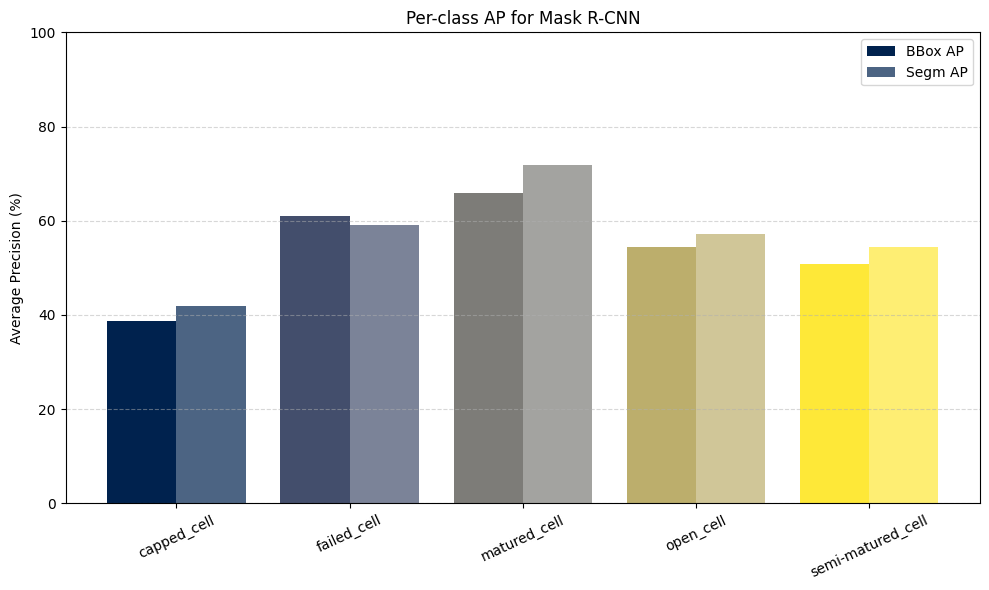

In [131]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

x = np.arange(len(classes))

colors = plt.cm.cividis(np.linspace(0, 1, len(classes)))

plt.figure(figsize=(10,6))
plt.bar(x - 0.2, bbox_ap, width=0.4, color=colors, label='BBox AP')
plt.bar(x + 0.2, segm_ap, width=0.4, color=colors, alpha=0.7, label='Segm AP')

plt.xticks(x, classes, rotation=25)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Mask R-CNN")
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


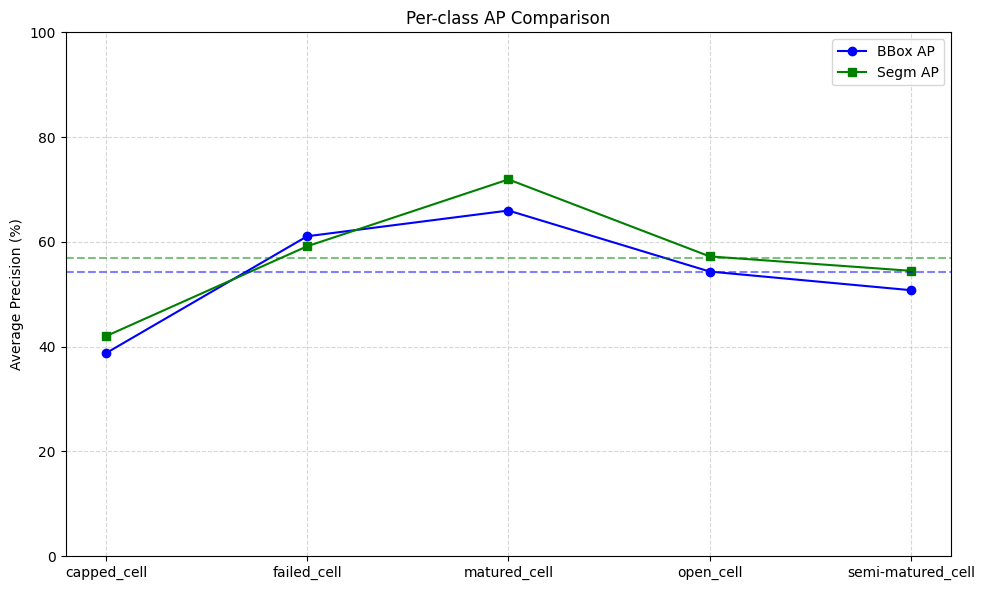

In [99]:
plt.figure(figsize=(10,6))
plt.plot(classes, bbox_ap, marker='o', label='BBox AP', color='blue')
plt.plot(classes, segm_ap, marker='s', label='Segm AP', color='green')
plt.axhline(np.mean(bbox_ap), color='blue', linestyle='--', alpha=0.5)
plt.axhline(np.mean(segm_ap), color='green', linestyle='--', alpha=0.5)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP Comparison")
plt.ylim(0, 100)
plt.grid(linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


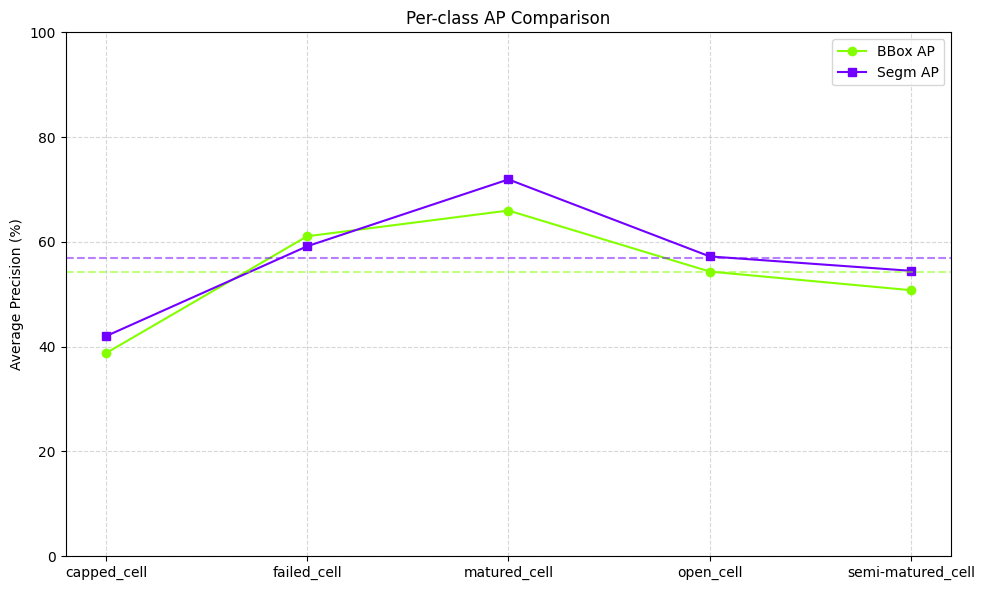

In [152]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

cmap = plt.cm.hsv
color1 = cmap(0.25)
color2 = cmap(0.75)
plt.figure(figsize=(10,6))
plt.plot(classes, bbox_ap, marker='o', label='BBox AP', color=color1)
plt.plot(classes, segm_ap, marker='s', label='Segm AP', color=color2)

plt.axhline(np.mean(bbox_ap), color=color1, linestyle='--', alpha=0.5)
plt.axhline(np.mean(segm_ap), color=color2, linestyle='--', alpha=0.5)

plt.ylabel("Average Precision (%)")
plt.title("Per-class AP Comparison")
plt.ylim(0, 100)
plt.grid(linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


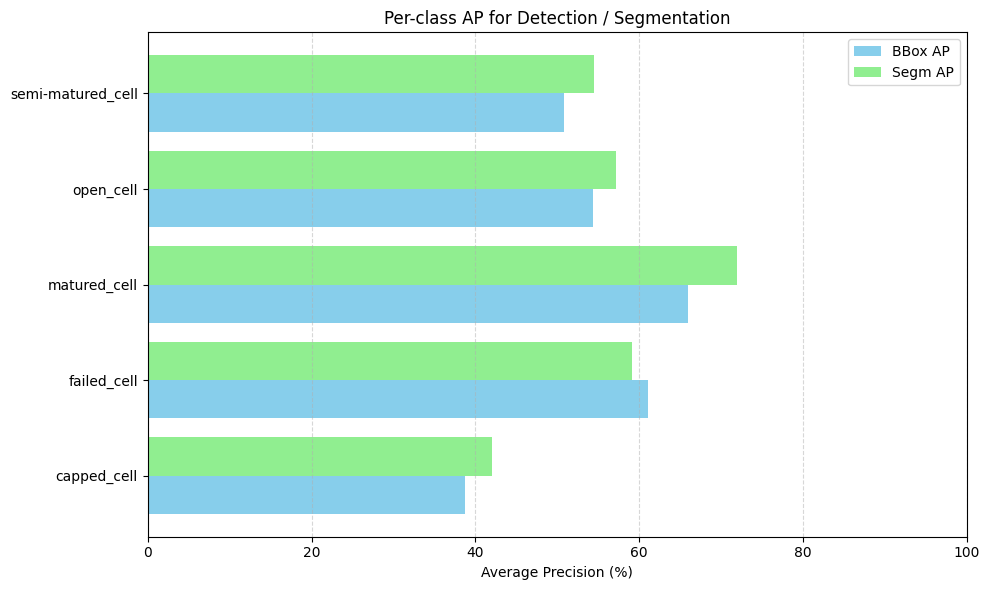

In [101]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

y = np.arange(len(classes))

plt.figure(figsize=(10,6))
plt.barh(y - 0.2, bbox_ap, height=0.4, label='BBox AP', color='skyblue')
plt.barh(y + 0.2, segm_ap, height=0.4, label='Segm AP', color='lightgreen')
plt.yticks(y, classes)
plt.xlabel("Average Precision (%)")
plt.title("Per-class AP for Detection / Segmentation")
plt.xlim(0, 100)
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


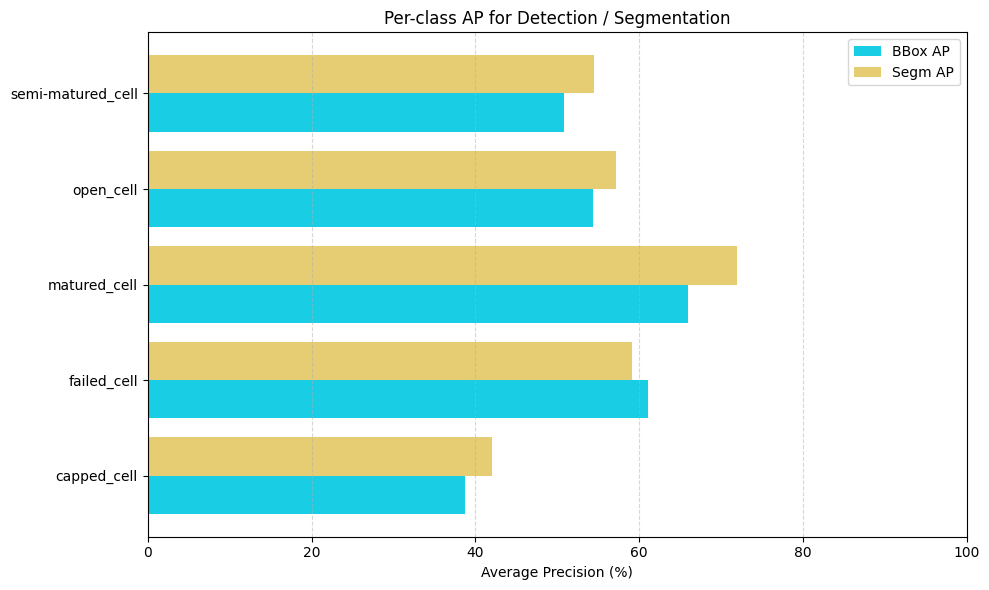

In [156]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

y = np.arange(len(classes))

cmap = plt.cm.rainbow
color1 = cmap(0.3)
color2 = cmap(0.7)

plt.figure(figsize=(10,6))
plt.barh(y - 0.2, bbox_ap, height=0.4, label='BBox AP', color=color1)
plt.barh(y + 0.2, segm_ap, height=0.4, label='Segm AP', color=color2)

plt.yticks(y, classes)
plt.xlabel("Average Precision (%)")
plt.title("Per-class AP for Detection / Segmentation")
plt.xlim(0, 100)
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


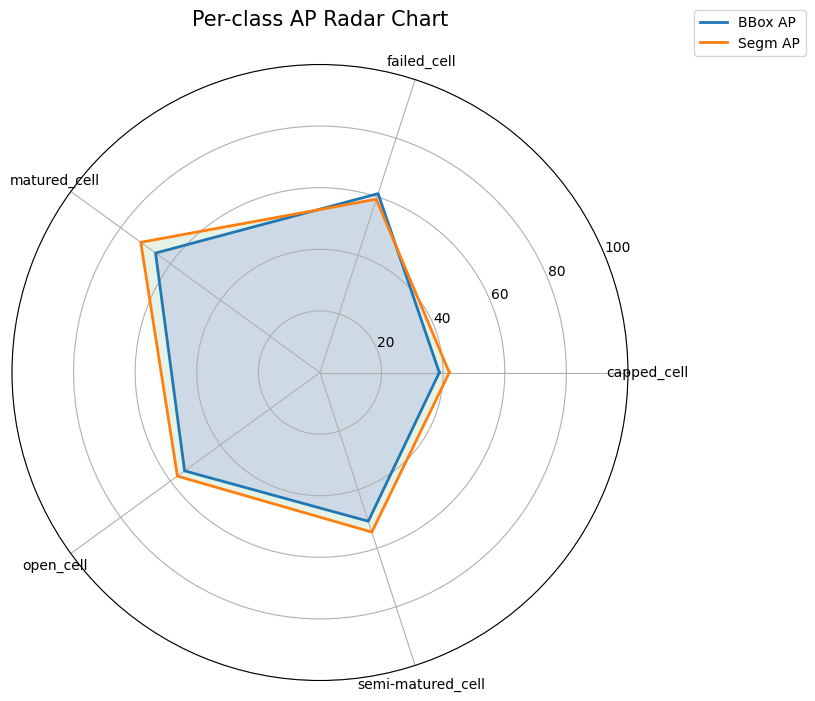

In [100]:
from math import pi
import matplotlib.pyplot as plt

categories = classes
N = len(categories)
bbox_values = bbox_ap
segm_values = segm_ap

angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]

bbox_values += bbox_values[:1]
segm_values += segm_values[:1]

plt.figure(figsize=(8,8))
ax = plt.subplot(111, polar=True)

ax.plot(angles, bbox_values, linewidth=2, linestyle='solid', label="BBox AP")
ax.fill(angles, bbox_values, 'blue', alpha=0.1)
ax.plot(angles, segm_values, linewidth=2, linestyle='solid', label="Segm AP")
ax.fill(angles, segm_values, 'green', alpha=0.1)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([20, 40, 60, 80, 100])
ax.set_yticklabels(['20', '40', '60', '80', '100'])
plt.title("Per-class AP Radar Chart", size=15, y=1.05)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


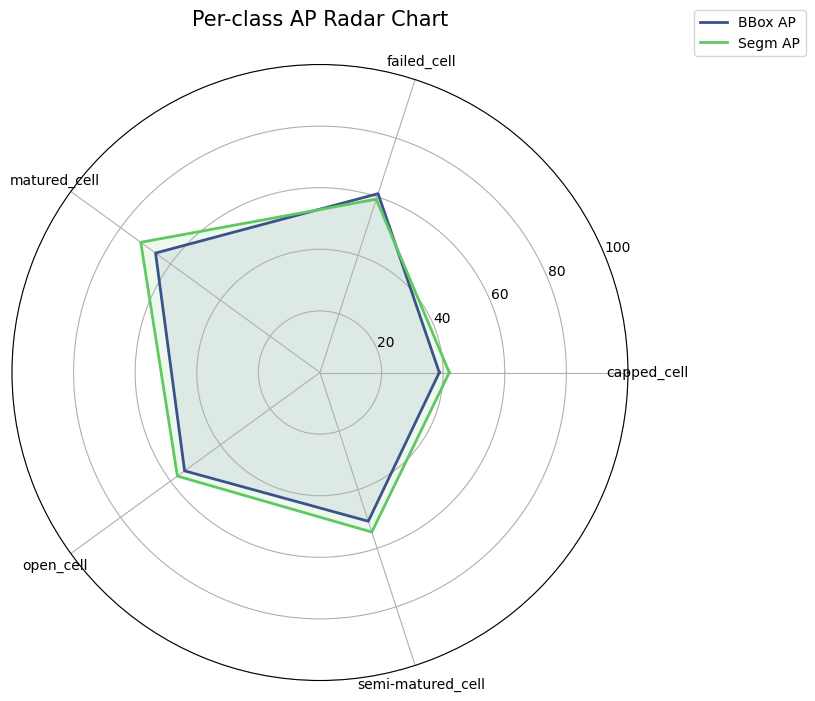

In [137]:
from math import pi
import matplotlib.pyplot as plt
import matplotlib as mpl

cmap = mpl.cm.get_cmap("viridis")
c1 = cmap(0.25)
c2 = cmap(0.75)

categories = classes
N = len(categories)
bbox_values = bbox_ap[:]
segm_values = segm_ap[:]

angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]

bbox_values += bbox_values[:1]
segm_values += segm_values[:1]

plt.figure(figsize=(8,8))
ax = plt.subplot(111, polar=True)

ax.plot(angles, bbox_values, linewidth=2, linestyle='solid', label="BBox AP", color=c1)
ax.fill(angles, bbox_values, color=c1, alpha=0.1)

ax.plot(angles, segm_values, linewidth=2, linestyle='solid', label="Segm AP", color=c2)
ax.fill(angles, segm_values, color=c2, alpha=0.1)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([20, 40, 60, 80, 100])
ax.set_yticklabels(['20', '40', '60', '80', '100'])

plt.title("Per-class AP Radar Chart", size=15, y=1.05)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


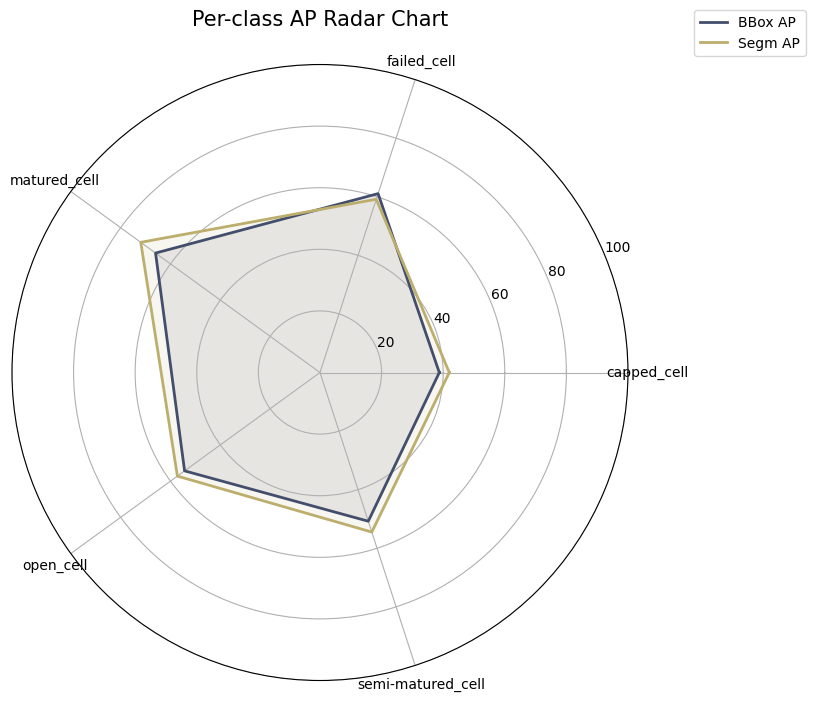

In [138]:
from math import pi
import matplotlib.pyplot as plt
import matplotlib as mpl

cmap = mpl.cm.get_cmap("cividis")
c1 = cmap(0.25)
c2 = cmap(0.75)

categories = classes
N = len(categories)
bbox_values = bbox_ap[:]
segm_values = segm_ap[:]

angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]

bbox_values += bbox_values[:1]
segm_values += segm_values[:1]

plt.figure(figsize=(8,8))
ax = plt.subplot(111, polar=True)

ax.plot(angles, bbox_values, linewidth=2, linestyle='solid', label="BBox AP", color=c1)
ax.fill(angles, bbox_values, color=c1, alpha=0.1)

ax.plot(angles, segm_values, linewidth=2, linestyle='solid', label="Segm AP", color=c2)
ax.fill(angles, segm_values, color=c2, alpha=0.1)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([20, 40, 60, 80, 100])
ax.set_yticklabels(['20', '40', '60', '80', '100'])

plt.title("Per-class AP Radar Chart", size=15, y=1.05)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()


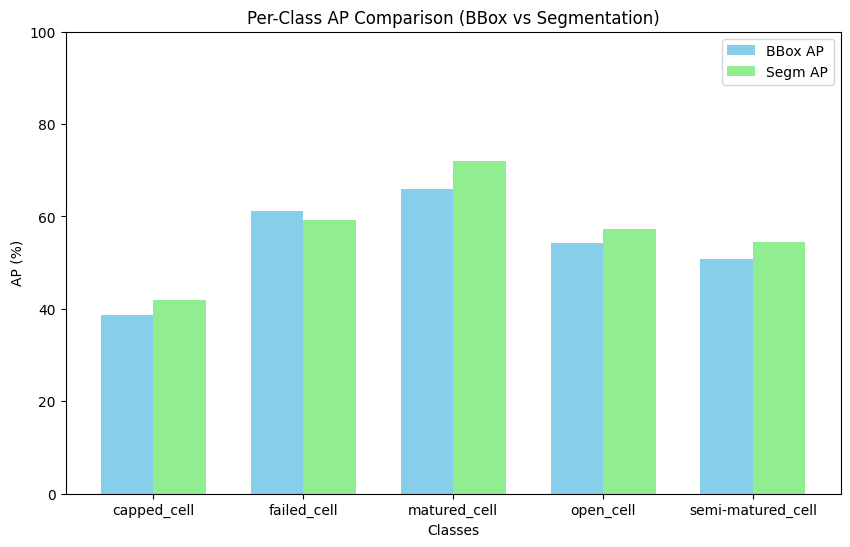

In [127]:
import matplotlib.pyplot as plt
import numpy as np

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

x = np.arange(len(classes))
width = 0.35

fig, ax = plt.subplots(figsize=(10,6))
ax.bar(x - width/2, bbox_ap, width, label='BBox AP', color='skyblue')
ax.bar(x + width/2, segm_ap, width, label='Segm AP', color='lightgreen')

ax.set_xlabel('Classes')
ax.set_ylabel('AP (%)')
ax.set_title('Per-Class AP Comparison (BBox vs Segmentation)')
ax.set_xticks(x)
ax.set_xticklabels(classes)
ax.legend()
plt.ylim(0, 100)
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


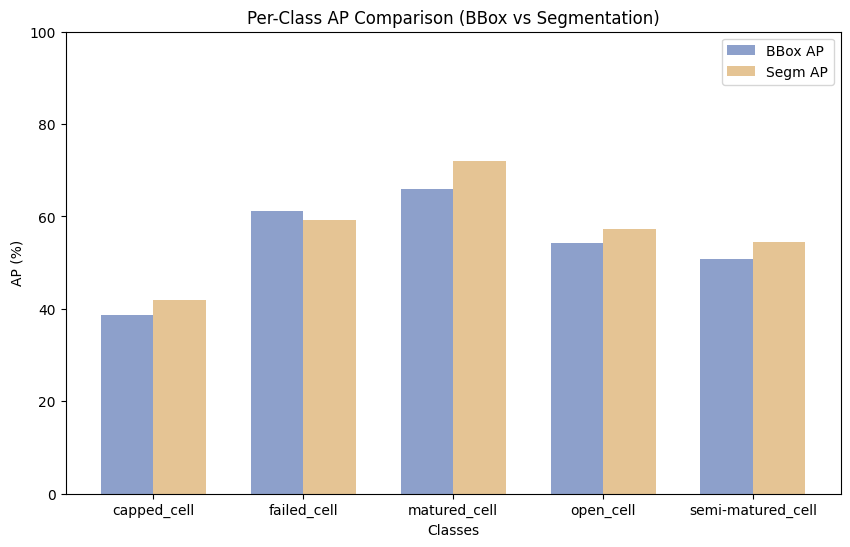

In [148]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

x = np.arange(len(classes))
width = 0.35

cmap = mpl.cm.get_cmap("Set2")

c_bbox = cmap(0.25)
c_segm = cmap(0.75)

fig, ax = plt.subplots(figsize=(10,6))
ax.bar(x - width/2, bbox_ap, width, label='BBox AP', color=c_bbox)
ax.bar(x + width/2, segm_ap, width, label='Segm AP', color=c_segm)

ax.set_xlabel('Classes')
ax.set_ylabel('AP (%)')
ax.set_title('Per-Class AP Comparison (BBox vs Segmentation)')
ax.set_xticks(x)
ax.set_xticklabels(classes)
ax.legend()
plt.ylim(0, 100)
plt.show()


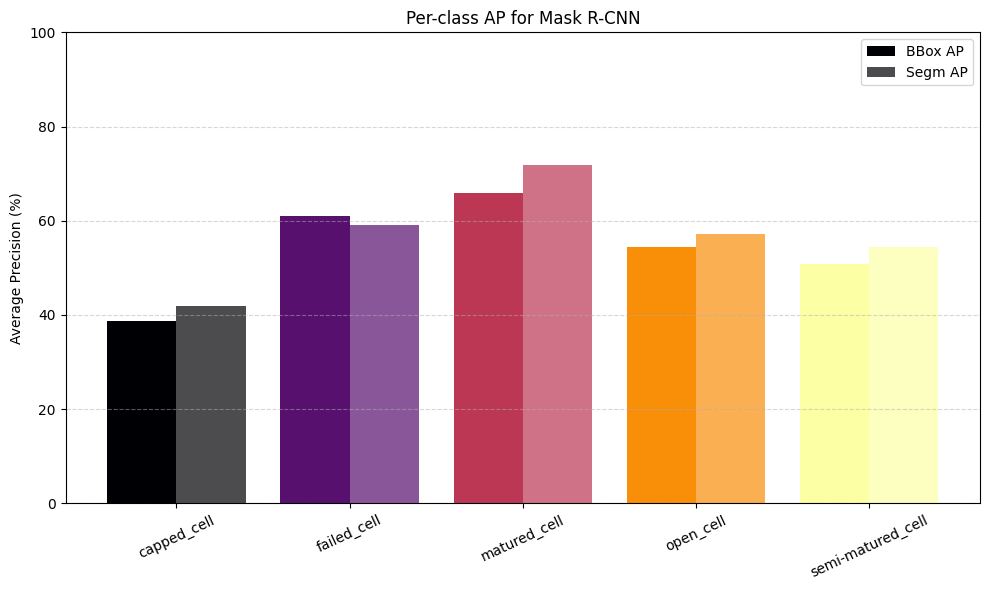

In [132]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]

x = np.arange(len(classes))

colors = plt.cm.inferno(np.linspace(0, 1, len(classes)))

plt.figure(figsize=(10,6))
plt.bar(x - 0.2, bbox_ap, width=0.4, color=colors, label='BBox AP')
plt.bar(x + 0.2, segm_ap, width=0.4, color=colors, alpha=0.7, label='Segm AP')

plt.xticks(x, classes, rotation=25)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Mask R-CNN")
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


## Interpreting Mask R-CNN Evaluation Results

The evaluation results provide several metrics to assess the performance of the Mask R-CNN model on the validation set. Here are some of the key metrics from the COCO evaluation:

*   **Average Precision (AP)**: This is the primary metric. It averages precision over different Intersection over Union (IoU) thresholds (from 0.5 to 0.95 with a step of 0.05). A higher AP indicates better performance.
    *   **AP @[ IoU=0.50:0.95 | area= all | maxDets=100 ]**: This is the overall AP across all object sizes and IoU thresholds. In your results, the **bbox AP is 54.178%** and the **segm AP is 56.953%**.
    *   **AP @[ IoU=0.50 | area= all | maxDets=100 ] (AP50)**: This is the AP calculated at an IoU threshold of 0.50. It's a common metric for evaluating object detection models. A higher AP50 means the model is good at finding objects with at least 50% overlap. In your results, the **bbox AP50 is 73.467%** and the **segm AP50 is 73.885%**.
    *   **AP @[ IoU=0.75 | area= all | maxDets=100 ] (AP75)**: This is the AP calculated at a stricter IoU threshold of 0.75. A higher AP75 indicates better localization accuracy. In your results, the **bbox AP75 is 62.331%** and the **segm AP75 is 66.073%**.

*   **AP across different object sizes**:
    *   **APs**: AP for small objects.
    *   **APm**: AP for medium objects.
    *   **APl**: AP for large objects.
    These metrics help understand how well the model performs on objects of different scales.

*   **Average Recall (AR)**: This metric measures the model's ability to find all the ground truth objects. It's averaged over different IoU thresholds and the number of detections per image.
    *   **AR @[ IoU=0.50:0.95 | area= all | maxDets=100 ]**: Overall AR across all sizes and IoU thresholds, considering up to 100 detections per image.

*   **Per-category AP**: The results also show the AP for each individual class. This helps identify which classes the model is performing well on and which ones might need more attention.

Based on your results:

*   **Overall Performance**: The model achieved a bbox AP of around 54.2% and a segm AP of around 57.0%. The AP50 values are significantly higher (around 73-74%), suggesting the model is reasonably good at detecting the presence of objects but less precise with localization at higher IoU thresholds (AP75 values are lower).
*   **Per-Category Performance**:
    *   For bounding boxes, 'matured_cell' has the highest AP (65.98%), while 'capped_cell' has the lowest (38.74%).
    *   For segmentation masks, 'matured_cell' also has the highest AP (71.92%), and 'capped_cell' again has the lowest (41.99%).

This indicates that the model performs best at detecting and segmenting 'matured_cell' instances and has more difficulty with 'capped_cell' instances.